In [1]:
using LinearAlgebra
using Plots
using Distributions
using Random
using LaTeXStrings

## Ising Model
The Ising Model is a model for ferromagnetism. It is one of the simplest models that describes a phase transition for certain cases. The model consists of a $d$ dimensional lattice where each lattice point is characterised by a "spin" which can take values 1 or -1. Each such arrangement of spins in the lattice constitutes a state. 

The Ising Hamiltonian is of the form:

$$\mathscr{H} =-J \sum \limits _{\langle i,j \rangle} \sigma_i \sigma_j -B \sum \limits _{i} \sigma_i $$
where ${\langle i,j \rangle}$ denotes the sum over nearest neighbours in the lattice, J denotes the interaction strength between the nearest neighbours. $\sigma_i$ denotes the $i^\text{th}$ spin. Thus, $\sigma_i= \pm 1 \ \ \forall \ i$

Here we simulate a 2D Ising Model using Monte Carlo Method: 

- Metropolis Algorithm
- Glauber Dynamics

Both the methods follow that the process to equilibrium is a Markov process, for which the transition to the next state is dependent only on the present state. 

### Algorithm (Metropolis)
1. Start from an initial state $\mu$
2. Choose a spin randomly from the lattice, say $\sigma_i$
3. Calculate the energy difference between the present state and the state $\nu $ when $\sigma_i$ is flipped, that is, $\sigma_i \rightarrow -\sigma_i$. Suppose the energy difference is $\triangle E = E_\mu - E_nu$
4. If $\triangle E \leq 0 $ then the spin will be flipped. Else, the spin maybe flipped but according to some probability. Perform the following to decide whether or not to flip the spin

    - Choose a random number between 0 and 1
    - Calculate the acceptance ratio. $A \propto \exp(-\beta \triangle E)$
    - If $r \leq A$, then do the flip, else leave the state alone.
5. Accept this new state $\nu $ after Step 4. 

### Algorithm (Glauber Dynamics)

The algorithm is similar to Metropolis, however, the probability by which we flip the spin is different. So, instead of step 4 above, we perform the following: 
- If $\triangle E < 0 $ then the spin will be flipped. Else if $\triangle E > 0 $, the spin maybe flipped but according to some probability. Perform the following to decide whether or not to flip the spin
    - Choose a random number between 0 and 1
    - Calculate the acceptance ratio. $A \propto 1/(1+\exp(\beta \triangle E))$
    - If $r \leq A$, then do the flip, else leave the state alone. 
    
If $\triangle E = 0 $ then the spin is flipped with probability 0.5


In [2]:
#FUnction to generate the initial state with +1 spins (with probability p)
function init_st(n, p)
    L=zeros(n,n); #creating a matrix which will be our lattice

    #assigning spins to lattice site according to probability p 
    for i =1:n
        for j = 1:n
            a=rand()
            if a<p
                L[i,j]=1
            else
                L[i,j]=-1
            end
        end
    end

    #imposing periodic boundary condition to ensure that boundary terms also get 4 neighbours
    L
end


init_st (generic function with 1 method)

In [3]:
#=Function to impose boudnary conditions:
if index site is less than 1, it returns n (the index of the opposite site of the lattice) and vice versa. 
this way, the whole lattice is wrapped around itself, satisfying PBC
=#
function boundary(i)
    if i<1
        return n
    elseif i>n
        return 1
    else
        return i
    end
end

boundary (generic function with 1 method)

In [4]:
#Metropolis
#defining range of beta for which to run
para=0.01:0.001:1.3
m_m=[]
s_m=[]
#lattice dimension
n=200

#creating initial state with random spins 
L= init_st(n, 0.5);

#running the metropolis algorithm
for k = 1:length(para)
    for i =1:10000
        b=para[k]
        #=t=rand(1:n,1,2) #choosing a random lattice point
        i=t[1]
        j=t[2]=#
        i=rand(1:n)
        j=rand(1:n)
        #a=L[i,j]
        S= -2*L[i,j]*(L[boundary(i+1),j]+L[boundary(i-1),j]+L[i,boundary(j+1)]+L[i,boundary(j-1)]) #calculating energy difference between the present state and if spin is flipped
        E_diff=-S

        #using the spin flip rules
        if E_diff<=0
                L[i,j]*=-1
        else
            A=exp(-b*E_diff)
            cnt=rand()
            if cnt<A
                L[i,j]*=-1
            end
        end
    end
    append!(m_m,sum(L)/(n*n))
    push!(s_m, copy(L))
end


for k = 1:length(para)-1
    for i =1:10000
        b=para[length(para)-k]
        #choosing a random lattice point
        i=rand(1:n)
        j=rand(1:n)
        #calculating energy difference between the present state and if spin is flipped
        S= -2*L[i,j]*(L[boundary(i+1),j]+L[boundary(i-1),j]+L[i,boundary(j+1)]+L[i,boundary(j-1)])
        E_diff=-S

        #using the spin flip rules
        if E_diff<=0
                L[i,j]*=-1
        else
            A=exp(-b*E_diff)
            cnt=rand()
            if cnt<A
                L[i,j]*=-1
            end
        end
    end
    append!(m_m,sum(L)/(n*n))
    push!(s_m, copy(L))
end

    
        

In [5]:
#Glauber Dynamics

#defining range of beta for which to run
para=0.01:0.001:1.7
m_g=[]
s_g=[]

#lattice dimension
n=200

#creating initial state with random spins 
L= init_st(n, 0.5);

#running the metropolis algorithm
for k = 1:length(para)
    for i =1:10000
        b=para[k]
        #=t=rand(1:n,1,2) #choosing a random lattice point
        i=t[1]
        j=t[2]=#
        i=rand(1:n)
        j=rand(1:n)
        #a=L[i,j]
        S= -2*L[i,j]*(L[boundary(i+1),j]+L[boundary(i-1),j]+L[i,boundary(j+1)]+L[i,boundary(j-1)]) #calculating energy difference between the present state and if spin is flipped
        E_diff=-S

        #using the spin flip rules
        if E_diff<=0
                L[i,j]*=-1
        elseif E_diff==0
            cnt=rand()
            if cnt<0.5
                L[i,j]*=-1
            end
        else
            A=1/(1+exp(b*E_diff))
            cnt=rand()
            if cnt<A
                L[i,j]*=-1
            end
        end
    end
    append!(m_g,sum(L)/(n*n))
    push!(s_g, copy(L))
end


for k = 1:length(para)-1
    for i =1:10000
        b=para[length(para)-k]
        #choosing a random lattice point
        i=rand(1:n)
        j=rand(1:n)
        #calculating energy difference between the present state and if spin is flipped
        S= -2*L[i,j]*(L[boundary(i+1),j]+L[boundary(i-1),j]+L[i,boundary(j+1)]+L[i,boundary(j-1)])
        E_diff=-S

        #using the spin flip rules
        if E_diff<0
                L[i,j]*=-1
        elseif E_diff==0
            cnt=rand()
            if cnt<0.5
                L[i,j]*=-1
            end
        else
            A=1/(1+exp(b*E_diff))
            cnt=rand()
            if cnt<A
                L[i,j]*=-1
            end
        end
    end
    append!(m_g,sum(L)/(n*n))
    push!(s_g, copy(L))
end

    
        

┌ Info: Saved animation to /home/shaggy1304/IISER/IAS SRFP/isi_metro.gif
└ @ Plots /home/shaggy1304/.julia/packages/Plots/HyyIK/src/animation.jl:156


Plots.AnimatedGif("/home/shaggy1304/IISER/IAS SRFP/isi_metro.gif")
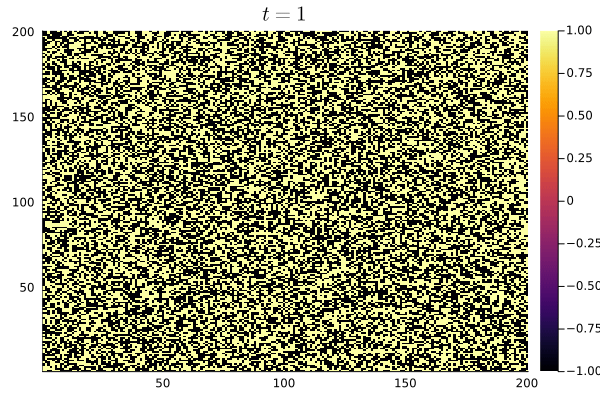

In [6]:
an=@animate for i=1: length(s_m)
    plot(heatmap(s_m[i]), title=L"t=%$i")
end
gif(an, "isi_metro.gif", fps = 10)

We first use Metropolis algorithm to simulate the dynamics of the Ising system. We first increase $\beta$ and then again decrease it. The animation shows that as $\beta$ is increases (Temperature is decreased), the system forms distinct domains which contain similar spins. Thus, the system approaches a ordered ferromagnetic phase. As temperature is again increased, the system becomes disordered with random spins.

┌ Info: Saved animation to /home/shaggy1304/IISER/IAS SRFP/isi_glaub.gif
└ @ Plots /home/shaggy1304/.julia/packages/Plots/HyyIK/src/animation.jl:156


Plots.AnimatedGif("/home/shaggy1304/IISER/IAS SRFP/isi_glaub.gif")
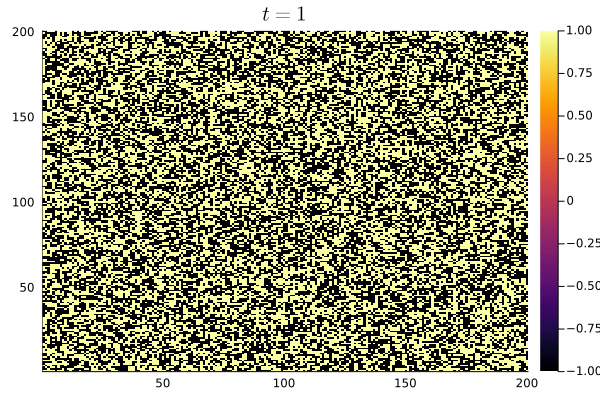

In [7]:
an=@animate for i=1: length(s_g)
    plot(heatmap(s_g[i]), title=L"t=%$i")
end
gif(an, "isi_glaub.gif", fps = 10)